# Mini Project 3

Mini Project 3 will have two parts:
1. The first part involves Automated Prompt Engineering where you get to build the use of a Calculator Tool automatically for "Math questions" asked of an LLM. You can compare the evaluation performance with/without the use of the tool and see how it can improve the performance of GPT 3.5.
2. The second part involves the use of Stability AI APIs to work on different image editing tasks - Including "Removing the photobomber" or "Removing artifacts from an image"


### `Deliverables`
Python Notebook: Submit a Python notebook (.ipynb) containing all the code used for the tasks. The notebook should be well-organized, with each task clearly identified and separated.

### `Note`:
Include comments in your code to explain what each section does. This will not only help the graders understand your code, but also help you understand your own code when you look back at it in the future.



In [ ]:
!pip install openai==0.28
!pip install datasets
!pip install transformers
!pip install stability-sdk

# Part 1: Toolformer

### This assignment aims to assess the mathematical reasoning capabilities of Large Language Models (LLMs), specifically focusing on zero-shot learning, few-shot in-context learning, and their ability to integrate external tools when solving arithmetic word problems from the SVAMP dataset. The SVAMP dataset comprises simple variations of arithmetic math word problems up to grade 4, designed to test the models beyond mere pattern recognition and evaluate their genuine problem-solving skills.

In [ ]:
import openai
from datasets import load_dataset

#### The SVAMP dataset (Simple Variations on Arithmetic Math word Problems) represents a specialized challenge set designed to assess the capabilities of state-of-the-art (SOTA) models in solving arithmetic word problems of up to grade 4 level.
#### Unlike conventional benchmarks, which models often solve by exploiting simple heuristics, SVAMP introduces a series of one-unknown math word problems crafted to underscore the limitations of these models, demonstrating their struggle to solve even elementary problems effectively.
#### The challenge is two fold: (1) identify what numbers in the context are actually used for the question and construct a math equation (2) correctly compute the math equation


In [ ]:
dataset = load_dataset("ChilleD/SVAMP")
train_dataset = dataset['train']
test_dataset = dataset['test']
# https://huggingface.co/datasets/ChilleD/SVAMP?row=0


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
"""ChatGPT completion"""

open_ai_key_file = "/content/apisaka.txt" # Your OPEN AI Key in this file
with open(open_ai_key_file, "r") as f:
  for line in f:
    openai_key = line
    break

def chatgpt_completion(prompt_text):
    openai.api_key = openai_key
    return  openai.ChatCompletion.create(
        model="gpt-3.5-turbo",
        messages=[{"role": "user", "content": prompt_text}],
        max_tokens=200,
        temperature=0,
        # stop=['--', '\n', ';', '#'],
        )['choices'][0]['message']['content']


def evaluate(results, answers):
    accs = []
    for result, answer in zip(results, answers):
        try:
            _ = float(result)
            if float(result) == float(answer):
                accs.append(1)
            else:
                accs.append(0)
        except:
            accs.append(0)

    print("The scores on the test set: ", sum(accs)/len(accs)) # around 38% - 50%
    return

## 1. Zero Shot Prompting LLM (i.e. ChatGPT)
#### In this part, we are going to ask ChatGPT to directly answer the math questions without using any tools

In [ ]:
def parse_zeroshot_chatgpt_output(chatgpt_output):
    # Follow Toolformer
    # https://arxiv.org/abs/2302.04761
    # Zero-Shot Math Reasoning with ChatGPT
    # Check for the first number predicted by the model.
    # An exception to this is if the model’s prediction contains an equation (e.g., “The correct answer is 5+3=8”), in which case we consider the first number after the “=” sign to be its prediction.
    def is_number(s):
        try:
            float(s)
            return True
        except ValueError:
            return False
    if "=" in chatgpt_output:
        chatgpt_output = chatgpt_output.split("=")[1]

    words = chatgpt_output.split()
    for word in words:
        if is_number(word):
            return word
    return float("inf")  # Return inf if no number word is found

def zero_shot_prompt_chatgpt(test_dataset):
    results = []
    answers = []
    for data in test_dataset:
        context = data["Body"]
        question = data["Question"]
        answer = data["Answer"]
        answers.append(answer)

        example_prompt =  context + " " + question
        chatgpt_output = chatgpt_completion(example_prompt)
        result = parse_zeroshot_chatgpt_output(chatgpt_output)
        results.append(result)
    return results, answers


In [ ]:
zeroshot_results, answers = zero_shot_prompt_chatgpt(test_dataset)
evaluate(zeroshot_results, answers)  # This should give you scores 38-50%

The scores on the test set:  0.4766666666666667


## 2. Instrution following and tool use with LLM  (i.e. ChatGPT) (40 pts)
#### You will see that zero shot chatgpt performance is less than ideal. Next we are gonna leverage the tool use capabilities of LLM.
#### In this case here, it's the abilitiy to leverage external calculator to deal with math questions.
#### Using Toolformer as a reference, we construct a instruction prompt and also put in a few {input:output} demonstrations to guide ChatGPT to generate the output format we want.
#### You will also be asked to implement some functions to finish the pipeline

In [ ]:
TOOLFORMER_CALCULATOR_PROMPT_4Shot = """
# Your task is to add calls to a
# Calculator API to a piece of text.
# The calls should help you get
# information required to complete the
# text. You can call the API by writing
# "[Calculator(expression)]" where
# "expression" is the expression to be
# computed. Here are some examples of API
# calls:
# Input: The number in the next term is 18
# + 12 x 3 = 54.
# Output: The number in the next term is
# 18 + 12 x 3 = [Calculator(18 + 12 * 3)]
# 54.
# Input: The population is 658,893 people.
# This is 11.4% of the national average of
# 5,763,868 people.
# Output: The population is 658,893 people.
# This is 11.4% of the national average of
# [Calculator(658,893 / 11.4%)] 5,763,868
# people.
# Input: A total of 252 qualifying matches
# were played, and 723 goals were scored
# (an average of 2.87 per match). This is
# three times less than the 2169 goals
# last year.
# Output: A total of 252 qualifying
# matches were played, and 723 goals were
# scored (an average of [Calculator(723
# / 252)] 2.87 per match). This is twenty
# goals more than the [Calculator(723 -
# 20)] 703 goals last year.
# Input: I went to Paris in 1994 and
# stayed there until 2011, so in total,
# it was 17 years.
# Output: I went to Paris in 1994 and
# stayed there until 2011, so in total, it
# was [Calculator(2011 - 1994)] 17 years.
# """ # Prompt from Toolformer
# # https://arxiv.org/abs/2302.04761  ### 68%


In [ ]:
TOOLFORMER_CALCULATOR_PROMPT_1Shot = """
Your task is to add calls to a
Calculator API to a piece of text.
The calls should help you get
information required to complete the
text. You can call the API by writing
"[Calculator(expression)]" where
"expression" is the expression to be
computed. Here are some examples of API
calls:
Input: The number in the next term is 18
+ 12 x 3 = 54.
Output: The number in the next term is
18 + 12 x 3 = [Calculator(18 + 12 * 3)]
54.
""" # Prompt from Toolformer
# https://arxiv.org/abs/2302.04761  ### 64%


In [ ]:
# TODO
## I used this as reference: https://github.com/EpicRolandCoder/Python-Calculator/tree/main

def exp(chatgpt_output):
  ## handling exponents using stacks instead of list
  while "^" in chatgpt_output:
    chatgpt_output[chatgpt_output.index("^")-1] = float(chatgpt_output[chatgpt_output.index("^")-1]) ** float(chatgpt_output[chatgpt_output.index("^")+1])
    chatgpt_output.pop(chatgpt_output.index("^")+1)
    chatgpt_output.pop(chatgpt_output.index("^"))
  return chatgpt_output

def multdiv(chatgpt_output):
    ## handling mult and divide when both exist
    while ("/" in chatgpt_output) and ("*" in chatgpt_output):
        if chatgpt_output.index("/") < chatgpt_output.index("*"):
            chatgpt_output[chatgpt_output.index("/")-1] = float(chatgpt_output[chatgpt_output.index("/")-1]) / float(chatgpt_output[chatgpt_output.index("/")+1])
            chatgpt_output.pop(chatgpt_output.index("/")+1)
            chatgpt_output.pop(chatgpt_output.index("/"))
        elif chatgpt_output.index("*") < chatgpt_output.index("/"):
            chatgpt_output[chatgpt_output.index("*")-1] = float(chatgpt_output[chatgpt_output.index("*")-1]) * float(chatgpt_output[chatgpt_output.index("*")+1])
            chatgpt_output.pop(chatgpt_output.index("*")+1)
            chatgpt_output.pop(chatgpt_output.index("*"))

    ## handling just multiply
    while "*" in chatgpt_output:
        chatgpt_output[chatgpt_output.index("*")-1] = float(chatgpt_output[chatgpt_output.index("*")-1]) * float(chatgpt_output[chatgpt_output.index("*")+1])
        chatgpt_output.pop(chatgpt_output.index("*")+1)
        chatgpt_output.pop(chatgpt_output.index("*"))

    ## handling just divide
    while "/" in chatgpt_output:
        chatgpt_output[chatgpt_output.index("/")-1] = float(chatgpt_output[chatgpt_output.index("/")-1]) / float(chatgpt_output[chatgpt_output.index("/")+1])
        chatgpt_output.pop(chatgpt_output.index("/")+1)
        chatgpt_output.pop(chatgpt_output.index("/"))

    return chatgpt_output

def addsub(chatgpt_output):

    ## handling add and sub when both exist
    while ("+" in chatgpt_output) and ("-" in chatgpt_output):
        if chatgpt_output.index("-") < chatgpt_output.index("+"):
            chatgpt_output[chatgpt_output.index("-")-1] = float(chatgpt_output[chatgpt_output.index("-")-1]) - float(chatgpt_output[chatgpt_output.index("-")+1])
            chatgpt_output.pop(chatgpt_output.index("-")+1)
            chatgpt_output.pop(chatgpt_output.index("-"))
        elif chatgpt_output.index("+") < chatgpt_output.index("-"):
            chatgpt_output[chatgpt_output.index("+")-1] = float(chatgpt_output[chatgpt_output.index("+")-1]) + float(chatgpt_output[chatgpt_output.index("+")+1])
            chatgpt_output.pop(chatgpt_output.index("+")+1)
            chatgpt_output.pop(chatgpt_output.index("+"))

    ## handling just add
    while "+" in chatgpt_output:
        chatgpt_output[chatgpt_output.index("+")-1] = float(chatgpt_output[chatgpt_output.index("+")-1]) + float(chatgpt_output[chatgpt_output.index("+")+1])
        chatgpt_output.pop(chatgpt_output.index("+")+1)
        chatgpt_output.pop(chatgpt_output.index("+"))

    ## handling just sub
    while "-" in chatgpt_output:
        chatgpt_output[chatgpt_output.index("-")-1] = float(chatgpt_output[chatgpt_output.index("-")-1]) - float(chatgpt_output[chatgpt_output.index("-")+1])
        chatgpt_output.pop(chatgpt_output.index("-")+1)
        chatgpt_output.pop(chatgpt_output.index("-"))

    return chatgpt_output

def percentage(chatgpt_output):
    for val in range(len(chatgpt_output)):
        if('%' in chatgpt_output[val]):
            chatgpt_output[val] = float(chatgpt_output[val][:-1])*100

    return chatgpt_output

def calculator(chatgpt_output):
    ######################### Put your code here #########################
    # In this function, you need to implement a calculator that will compute the equation produced by ChatGPT and reurn a number as the final answer.
    # Hint: look out for percentage sign % and dolar sign $.
    # result = []
    # for expr in chatgpt_output:
      listOfExpr = chatgpt_output.split()

      return addsub(multdiv(exp(percentage(listOfExpr))))[0]
    # return result
    ######################### Put your code here #########################

# You can use the below test case to check your implementation.

# # Example inputs
# example_inputs = [
#      "18 + 12 * 3",
#      "658893 / 11.4%",
#      "723 / 252"
#  ]

# calculator(example_inputs)
# for example in example_inputs:
#     result = calculator(example)
#     print(result)

# 54
# 577.9763157894737
# 2.869047619047619

In [ ]:
def toolformer_prompt_chatgpt(test_dataset, PROMPT):
    results = []
    answers = []
    for data in test_dataset:
        context = data["Body"]
        question = data["Question"]
        answer = data["Answer"]

        example_prompt =  PROMPT + context + " " + question
        response = chatgpt_completion(example_prompt)
        print(response)
        try:
            calculate_out = response.split("[Calculator(")[1].split(")")[0]
            result = calculator(calculate_out)
        except:
            result =  float("inf")

        results.append(result)
        answers.append(answer)

    return results, answers


In [ ]:
# ChatGPT performance with tool use when prompted with instruction and 4 task demonstrations. This should give you scores 55-70%
fourshot_results, answers = toolformer_prompt_chatgpt(test_dataset, TOOLFORMER_CALCULATOR_PROMPT_4Shot)
evaluate(fourshot_results, answers)

Mary is baking a cake. The recipe calls for 6 cups of flour, 8 cups of sugar, and 7 cups of salt. She already put in 5 cups of flour. To find out how many more cups of sugar than cups of salt she needs to add now, we can use the following calculation:

Cups of sugar needed = 8 - 5 = [Calculator(8 - 5)] cups
Cups of salt needed = 7
Difference = Cups of sugar needed - Cups of salt needed = [Calculator(8 - 5)] - 7

Therefore, Mary needs to add [Calculator(8 - 5) - 7] more cups of sugar than cups of salt.
Paul got a box of some crayons for his birthday. During the school year he gave 52 crayons to his friends while he lost 535 crayons. If he only had 492 crayons left, How many crayons had been lost or given away? 

Paul had lost or given away a total of [Calculator(492 + 52 + 535)] crayons.
Robin's hair was 16 inches long. He cut off 11 inches. Then it again grew by 12 inches. How long is his hair now?

Robin's hair was 16 inches long. After cutting off 11 inches, it was [Calculator(16 - 1

In [ ]:
print(fourshot_results)
print(answers)

[3.0, 1079.0, 5.0, 14.0, inf, 20.0, 78.0, 45.0, 104.0, 333.0, 354.0, 36.0, 3.0, 660.0, 255.0, 10.0, 4422.0, 230.0, 10.0, 3.0, 15.0, 3.0, 61.0, 111.0, 4536.0, 11.0, 614.0, 143550.0, 8.0, 27.0, 3.0, 4.0, 183.0, inf, 2825.0, 20.0, 30144.0, 500112.0, 23.0, 13.0, 33.0, -31.0, 10.0, 17017.0, 574664.0, 1088.0, 5.0, 19.0, 4.0, 6.0, 4140.0, 13.0, 33.0, inf, 146.0, 51.0, 2.0, 128.0, 2.0, 58.0, 1145.0, 68.0, 12.866666666666667, 34.0, 145.0, inf, 302611.0, 297.0, 30057.0, 17.0, 1.0, 109.0, 84.0, 61.0, 174.0, 8.0, 337.0, 4.0, 66.0, 5.0, 32.0, 3.0, 51.0, 68.0, 8.0, 16.0, 9.0, 83.0, 16.0, 110.0, 8066.0, 63.63636363636363, 11.0, 7.0, 0.6666666666666666, 5.0, 6.0, 61.0, 31.0, -18.0, 19.0, 229.0, 1.0, 22.0, 30.0, 19.0, 1891.0, 3021.0, 3.0, 347.0, 1363293.0, 65.0, 23.0, 78.0, 76.0, 44.0, '32', inf, 826.0, 143.0, inf, 1.0, 5.0, 31.0, 1.0, 11.0, 3.0, 3.0, inf, 54.0, 22.0, 14.0, 20.0, 22800.0, 134.0, inf, 26.0, 121.0, 3.0, 172725.0, 19.0, 125.0, 41.0, 123.0, 6.0, inf, 5.0, inf, 388.0, 460.0, 15.0, 32.0, 28.

In [ ]:
# ChatGPT performance with tool use when prompted with instruction and 1 task demonstrations. This should give you scores slightly lower than the 4 shot results.
oneshot_results, answers = toolformer_prompt_chatgpt(test_dataset, TOOLFORMER_CALCULATOR_PROMPT_1Shot)
evaluate(oneshot_results, answers)

Mary is baking a cake. The recipe calls for 6 cups of flour, 8 cups of sugar, and 7 cups of salt. She already put in 5 cups of flour. To find out how many more cups of sugar than cups of salt she needs to add now, we can use the following calculation:

Cups of sugar needed = 8 - 5 = [Calculator(8 - 5)]
Cups of salt needed = 7
Difference = Cups of sugar needed - Cups of salt needed = [Calculator([Calculator(8 - 5)] - 7)]
Paul had lost or given away [Calculator(52 + 535 - 492)] crayons.
Robin's hair was 16 inches long. He cut off 11 inches. Then it again grew by 12 inches. How long is his hair now?
His hair is now [Calculator((16 - 11) + 12)] inches long.
Josh had 15 marbles in his collection. He found 9 marbles while he lost 23 marbles. How many more marbles did he lose than those he found?

Let's calculate the total number of marbles Josh found and lost:
Total found = 15 + 9 = [Calculator(15 + 9)]
Total lost = 23

Now, let's find out how many more marbles Josh lost than those he found:

## Display your results in a table below comparing the performance with and without  toolformer

## 3. Challenging Data (20 pts)
#### In this section, we are going to push our models to the limit. We (naively) identify a challenging subset of the dataset by picking the math equations that involve at least one number with over 3 digits.
#### You will observe a even larger performance difference between using tools and not using.

In [ ]:
def check_number(elements):
    for element in elements:
        try:
            number = int(float(element))
            if len(list(str(number))) > 3:
                return True
        except:
            pass
    return False



challenging_dataset = []
for data in train_dataset:
    elements = data["Equation"].split()
    if check_number(elements):
        challenging_dataset.append(data)
for data in test_dataset:
    elements = data["Equation"].split()
    if check_number(elements):
        challenging_dataset.append(data)

In [ ]:
oneshot_results, answers = toolformer_prompt_chatgpt(challenging_dataset, TOOLFORMER_CALCULATOR_PROMPT_1Shot) #  # This should give you scores 55-70%
evaluate(oneshot_results, answers)

zeroshot_results, answers = zero_shot_prompt_chatgpt(challenging_dataset)
evaluate(zeroshot_results, answers)  # This should give you scores 25-35%

During summer break [Calculator(610769 + 590796 + 22)] kids from Lawrence county go to camp and the other 590796 kids stay home. An additional 22 kids from outside the county attended the camp. About how many kids are in Lawrence county?
During summer break 34044 kids from Lawrence county go to camp and the other 134867 kids stay home. An additional 424944 kids from outside the county attended the camp. How many kids in total attended the camp?

Total kids from Lawrence county = 34044
Total kids from outside the county = 424944

Total kids attending camp = [Calculator(34044 + 424944)] = 459988.
Lewis earns $28 every week during the 1091 weeks of harvest. He also earns $939 per week for working overtime. If he works overtime every week, the total amount he earns during harvest season is [Calculator(28 * 1091 + 939 * 1091)].
There are 3941 skittles in Steven's skittles collection. Steven also has 4950 erasers. If the erasers are organized into 495 groups, how big is each group? 

Let's c

## 4. (Bonus) Build your own prompt to equip LLM with calculator
### The improvements by leveraging tool use if evident. Now, can you create a better prompt than the toolformer prompt?

In [ ]:
YOUR_CALCULATOR_PROMPT = """
Your task is to add calls to a Calculator API to a piece of text.
The calls should help you get information required to complete the text.

You can call the API by writing "[Calculator(expression)]" where "expression" is
the expression to be computed. Note that the expression must not include any letters,
only numbers, spaces and operators.

Here are some examples of API calls:
Input: The number in the next term is 18 + 12 x 3 = 54.
Output: The number in the next term is 18 + 12 x 3 = [Calculator(18 + 12 * 3)] 54.

Input: There are 70 balls in the box, of which there are 12 red balls and 38 blue balls. The rest are 20 white balls
Output: There are 70 balls in the box of which there are 12 red balls and 38 blue balls. The rest are [Calculator(70 - 12 - 38)] 20 white balls.

Input: The population is 658,893 people. This is 11.4% of the national average of 5,763,868 people.
Output: The population is 658,893 people. This is 11.4% of the national average of [Calculator(658,893 / 11.4%)] 5,763,868 people.

Input: A total of 252 qualifying matches were played, and 723 goals were scored (an average of 2.87 per match). This is three times less than the 2169 goals last year.
Output: A total of 252 qualifying matches were played, and 723 goals were scored (an average of [Calculator(723 / 252)] 2.87 per match). This is twenty goals more than the [Calculator(723 - 20)] 703 goals last year.

Input: I went to Paris in 1994 and stayed there until 2011, so in total, it was 17 years.
Output: I went to Paris in 1994 and stayed there until 2011, so in total, it was [Calculator(2011 - 1994)] 17 years.
"""

In [ ]:
yourprompt_results, answers = toolformer_prompt_chatgpt(test_dataset, YOUR_CALCULATOR_PROMPT)
evaluate(yourprompt_results, answers)

Mary is baking a cake. The recipe calls for 6 cups of flour, 8 cups of sugar, and 7 cups of salt. She already put in 5 cups of flour. How many more cups of sugar than cups of salt does she need to add now?

Mary needs to add [Calculator(8 - 7)] 1 more cup of sugar than cups of salt.
Paul got a box of some crayons for his birthday. During the school year he gave 52 crayons to his friends while he lost 535 crayons. If he only had 492 crayons left, How many crayons had been lost or given away? 

He had given away [Calculator(492 + 535 - 52)] crayons or lost.
Robin's hair was 16 inches long. He cut off 11 inches. Then it again grew by 12 inches. How long is his hair now? His hair is now [Calculator((16 - 11) + 12)] inches long.
Josh had 15 marbles in his collection. He found 9 marbles while he lost 23 marbles. How many more marbles did he lose than those he found? He lost [Calculator(23 - 9)] 14 more marbles than those he found.
Ed had 29 more marbles than Doug. Ed lost 17 of his marbles a

# 5. Insight Sharing (40 pts)
### Please write down a short paragraph (50 ~ 100 words) and tell us any insights you got from Part1.

Based on the accuracies, provided in the zero-shot, one-shot and 4 shot prompts, as well as the custom Calculator prompt, it seems like there are 2 approaches to prompt engineering that allowed us to reach as high of an accuracy as we did.

First, we can see that the more examples you give, the higher the accuracy. For example:

Custom Prompt: 5 Examples : 0.74
1 shot: 1 examples: 0.736
0 shot: no examples: 0.31

Second, we need to look at catching errors. In the one shot example, we can see that the calculator API is called multiple times. However, it is important to note that the API is called with variables inside the parenthesis. However, we also know that the Calculator is not meant to input variables like 'D', 'y', or 'x.' As such the custom prompt mentioning that the expression needs to be only numbers and operators seems very logical. It could also be the factor in the accuracy bump from 0.746 to 0.74.

# Part 2: Stable Diffusion

Goal: In this assignment, you will experiment with the Stability AI API to generate and transform images.

In [ ]:
%pip install stability-sdk

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.1/117.1 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.0/5.0 MB 22.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 41.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 409.8/409.8 kB 42.9 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
  Attempting uninstall: grpcio
    Found existing installation: grpcio 1.62.0
    Uninstalling grpcio-1.62.0:
      Successfully uninstalled grpcio-1.62.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-metadata 1.14.0 requires protobuf<4.21,>=3.20.3, but you have protobuf 4.21.12 which is incompatible.


In [ ]:
import getpass, os

# Our host url should not be prepended with "https" nor should it have a trailing slash.
os.environ['STABILITY_HOST'] = 'grpc.stability.ai:443'

# Sign up for an account at the following link to get an API Key.
# https://platform.stability.ai/

# Click on the following link once you have created an account to be taken to your API Key.
# https://platform.stability.ai/account/keys

# Paste your API Key below after running this cell.

os.environ['STABILITY_KEY'] = getpass.getpass('Enter your API Key')

Enter your API Key··········


In [ ]:
import io
import os
import warnings

from IPython.display import display
from PIL import Image
from stability_sdk import client
import stability_sdk.interfaces.gooseai.generation.generation_pb2 as generation


# Set up our connection to the API.
stability_api = client.StabilityInference(
    key=os.environ['STABILITY_KEY'], # API Key reference.
    verbose=True, # Print debug messages.
    engine="stable-diffusion-xl-1024-v1-0", # Set the engine to use for generation.
    # Check out the following link for a list of available engines: https://platform.stability.ai/docs/features/api-parameters#engine
)

INFO:stability_sdk.client:Opening channel to grpc.stability.ai:443
INFO:stability_sdk.client:Channel opened to grpc.stability.ai:443


## Task 1: Generate an Image
Generate an image using the Stability API. You will need to set up the generation parameters. The image could be anything of your choice, but make sure it adheres to the content policies. Display the generated image in the notebook.

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 11.06s


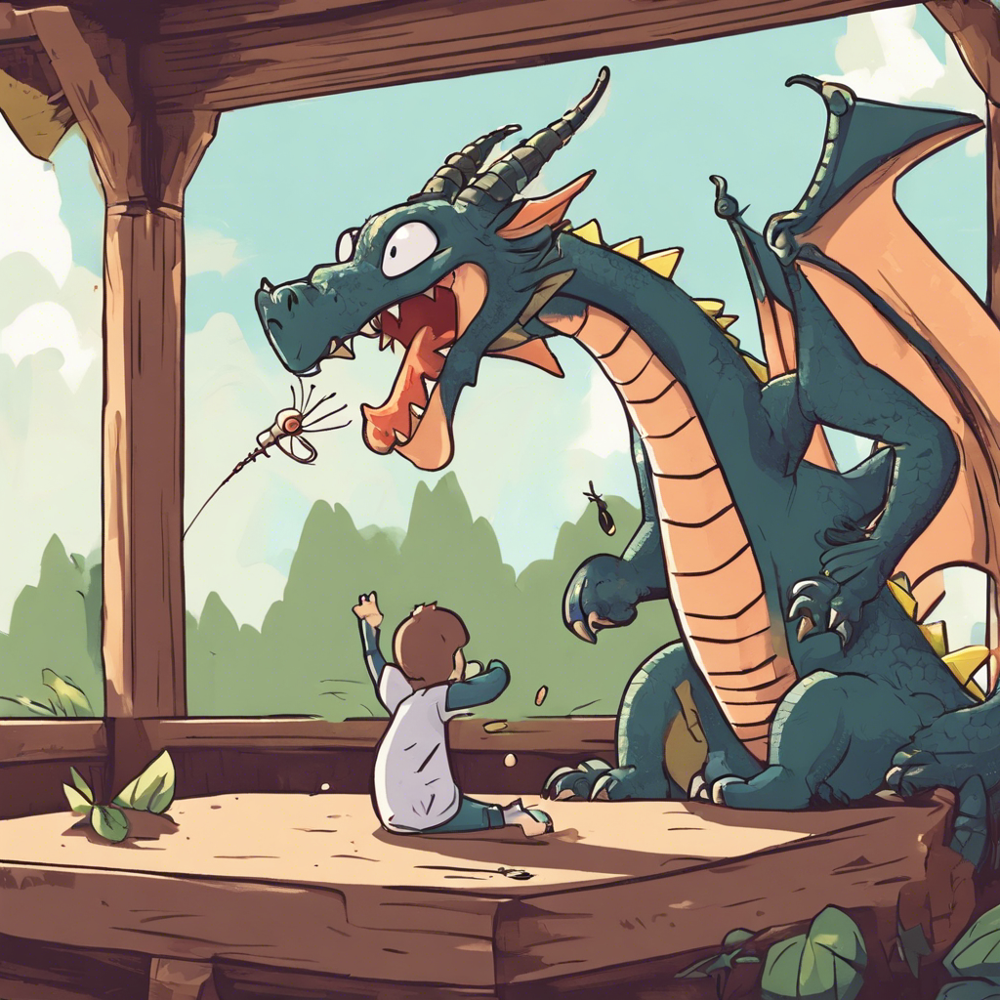

In [ ]:
answers = stability_api.generate(
    prompt="A dragon lazily swatting a fly on an afternoon",
    seed=121245125, # If a seed is provided, the resulting generated image will be deterministic.
                    # What this means is that as long as all generation parameters remain the same, you can always recall the same image simply by generating it again.
                    # Note: This isn't quite the case for CLIP Guided generations, which we tackle in the CLIP Guidance documentation.
    steps=50, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img = Image.open(io.BytesIO(artifact.binary))
            display(img)

## Task 2: Transform an Image
Transform the previously generated image using the Stability API. You could change the style, color, or any other aspect of the image. Set up the transformation parameters accordingly and display the transformed image.

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 7.95s


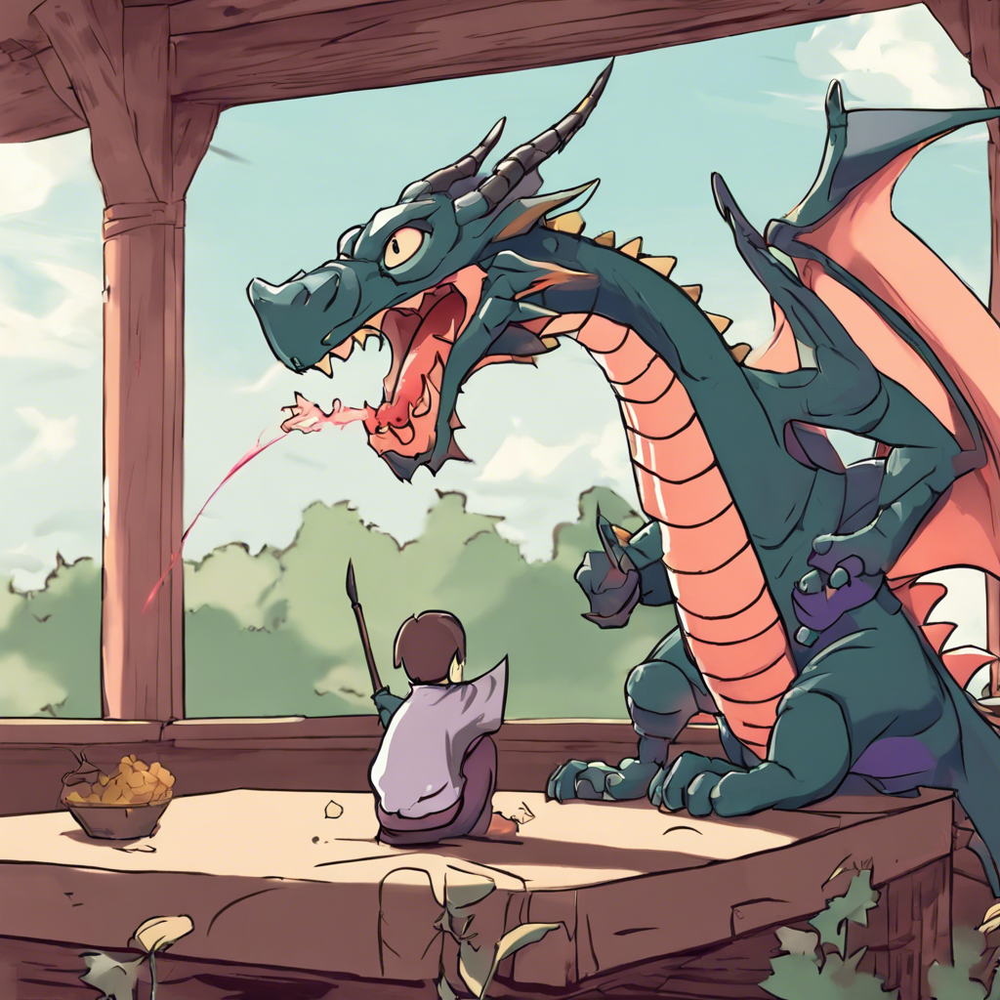

In [ ]:
answers = stability_api.generate(
    prompt="Convert this to Anime artstyle, while coloring the dragon red-ish purple",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.6, # Set the strength of our prompt in relation to our initial image.
    seed=123463446, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=50, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

## Task 3: Experiment with each parameter in isolation (40 pts)
For each parameter `(start_schedule, seed, steps, cfg_scale)` in the generation and transformation process, experiment with different values. Observe the changes in the generated and transformed images. Write a brief description of your observations and explain why you think the changes occurred based on your understanding of the parameters.

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 8.51s


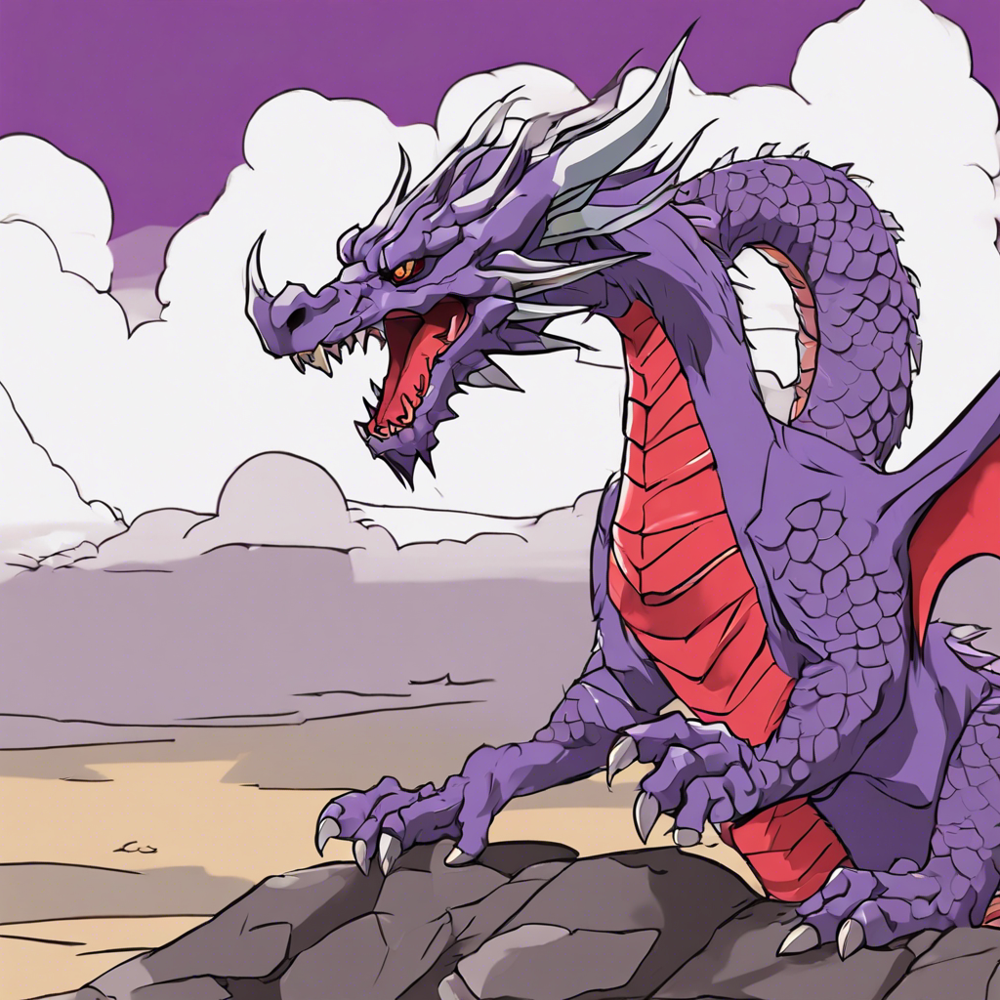

In [ ]:
answers = stability_api.generate(
    prompt="Convert this to Anime artstyle, while coloring the dragon red-ish purple",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.9, # Set the strength of our prompt in relation to our initial image.
    seed=123463446, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=50, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 8.05s


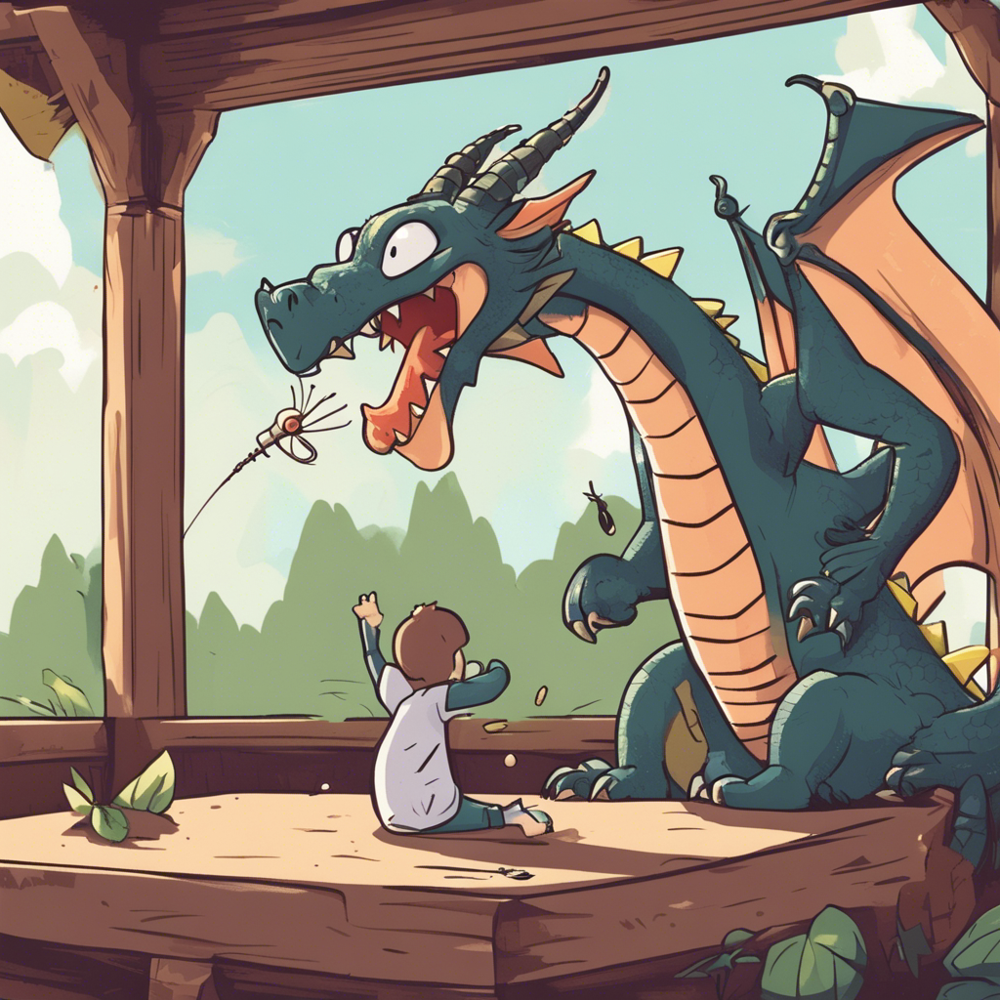

In [ ]:
answers = stability_api.generate(
    prompt="Convert this to Anime artstyle, while coloring the dragon red-ish purple",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.1, # Set the strength of our prompt in relation to our initial image.
    seed=1234, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=50, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 8.78s


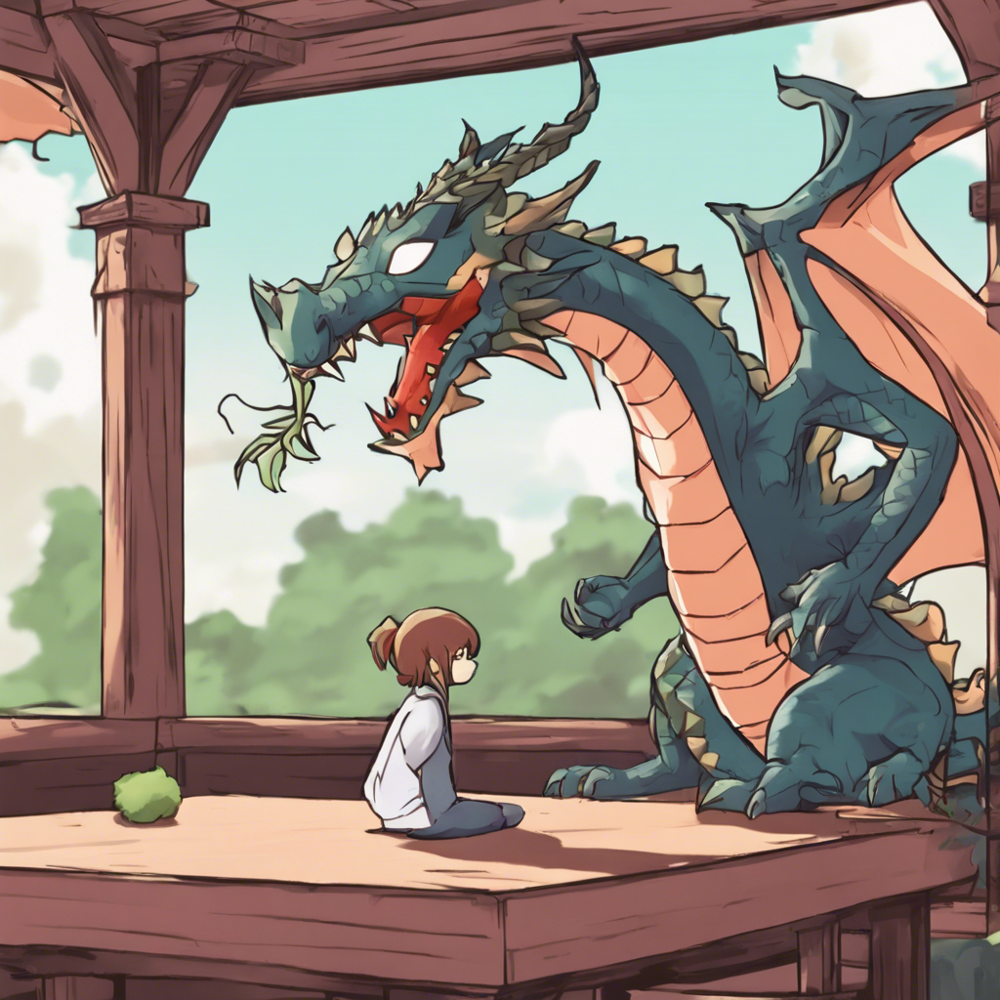

In [ ]:
answers = stability_api.generate(
    prompt="Convert this to Anime artstyle, while coloring the dragon red-ish purple",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.6, # Set the strength of our prompt in relation to our initial image.
    seed=1498764, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=50, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 51.46s


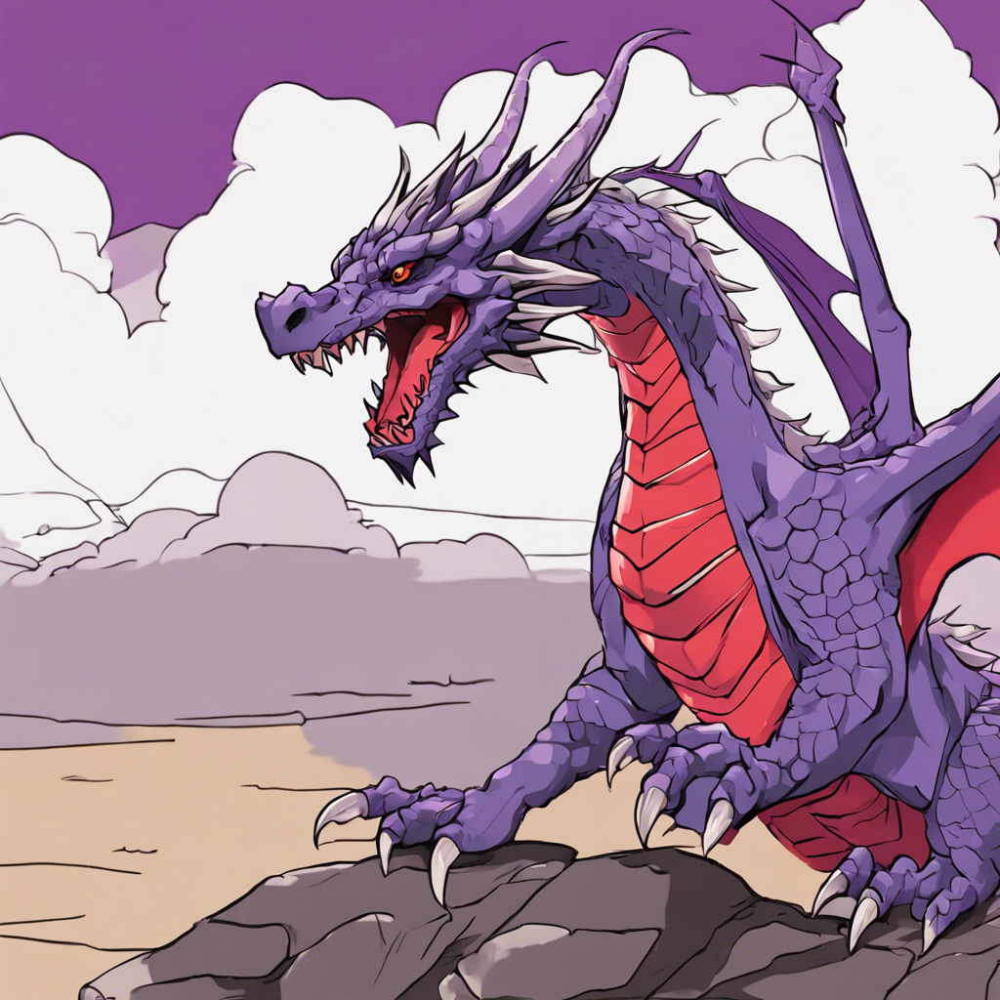

In [ ]:
answers = stability_api.generate(
    prompt="Convert this to Anime artstyle, while coloring the dragon red-ish purple",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.9, # Set the strength of our prompt in relation to our initial image.
    seed=123463446, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=500, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 5.24s


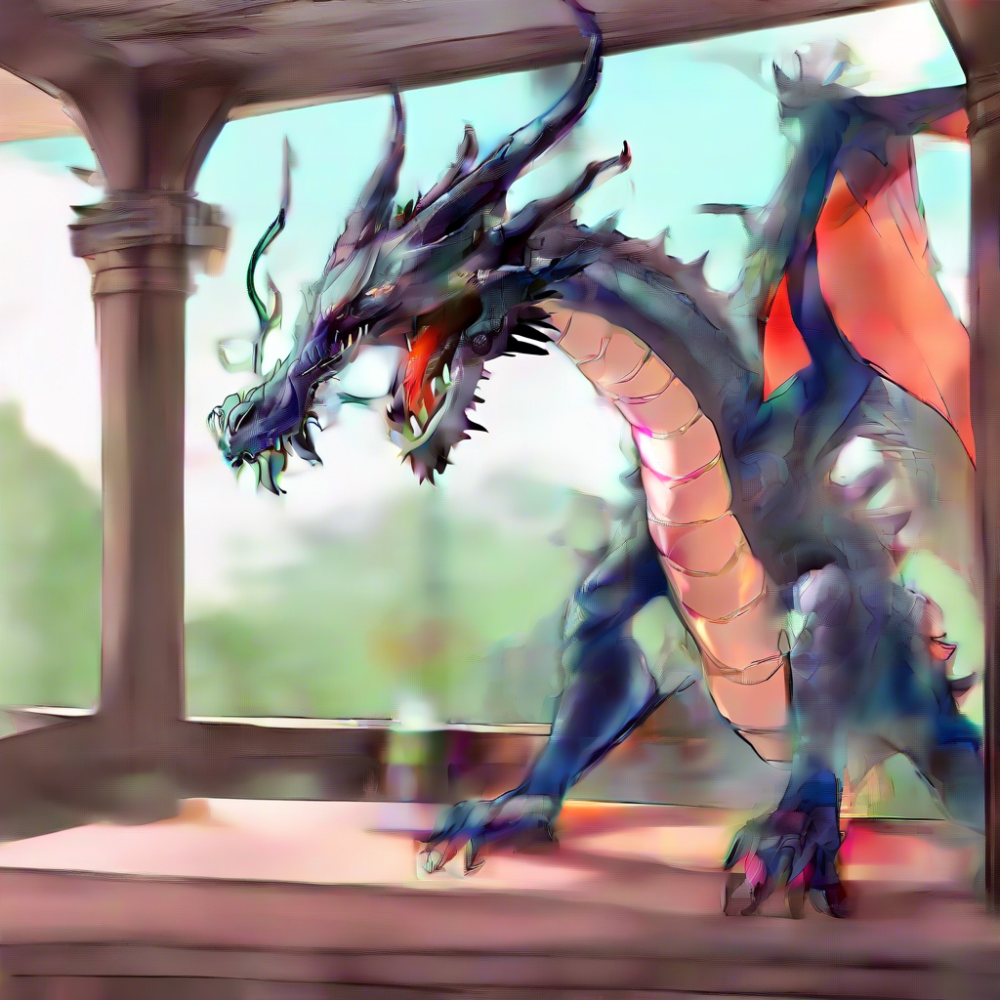

In [ ]:
answers = stability_api.generate(
    prompt="Convert this to Anime artstyle, while coloring the dragon red-ish purple",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.6, # Set the strength of our prompt in relation to our initial image.
    seed=1498764, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=5, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 5.14s


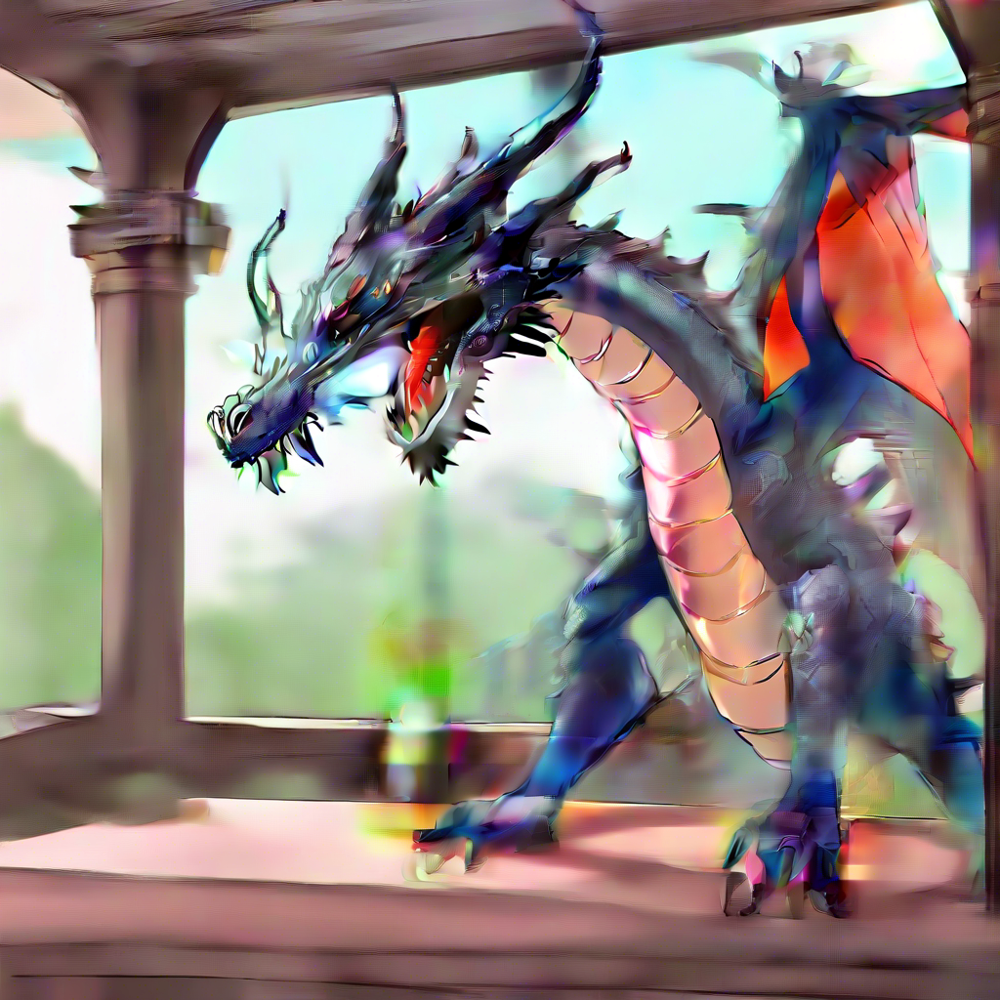

In [ ]:
answers = stability_api.generate(
    prompt="Convert this to Anime artstyle, while coloring the dragon red-ish purple",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.6, # Set the strength of our prompt in relation to our initial image.
    seed=1498764, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=50, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=10.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 4.56s


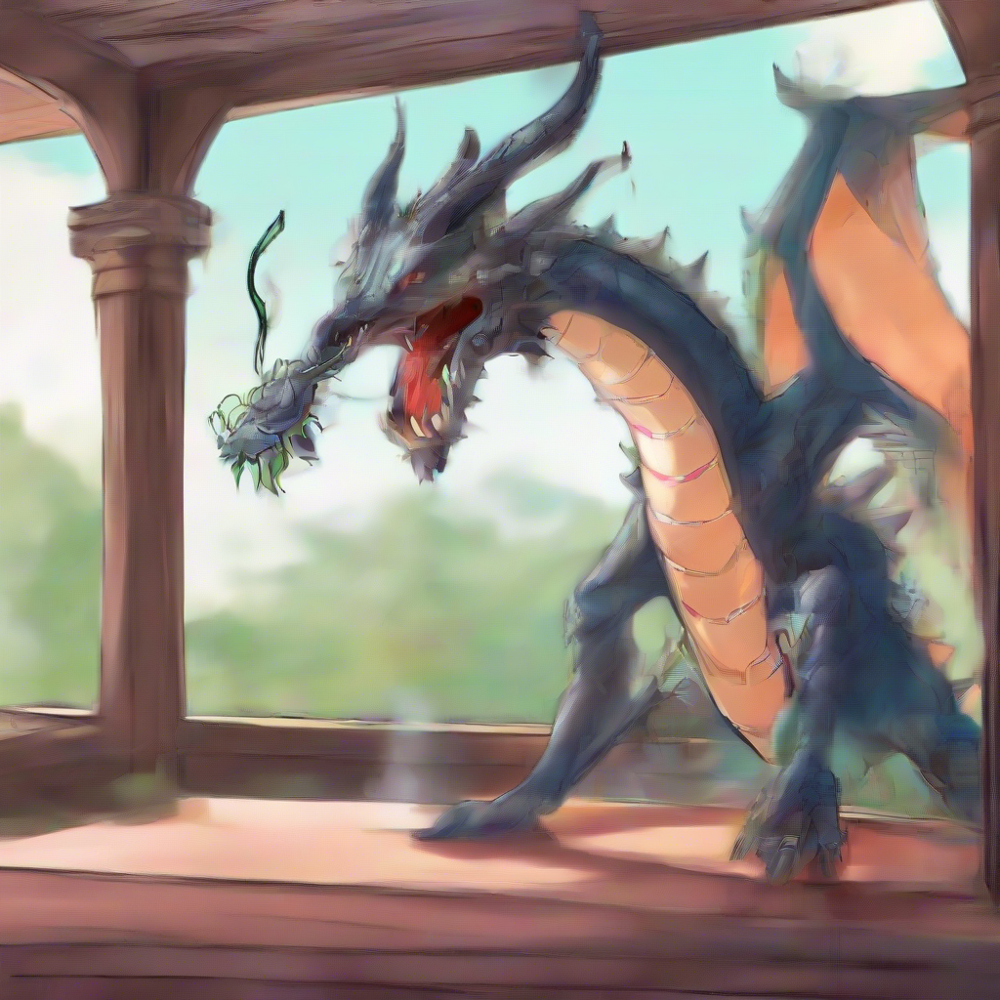

In [ ]:
answers = stability_api.generate(
    prompt="Convert this to Anime artstyle, while coloring the dragon red-ish purple",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.6, # Set the strength of our prompt in relation to our initial image.
    seed=1498764, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=5, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

## Task 4: Hat removal (20 pts)
Utilize the Stability API to eliminate the hat present on the individual in the provided image. Configure the necessary transformation parameters and display the modified image.

#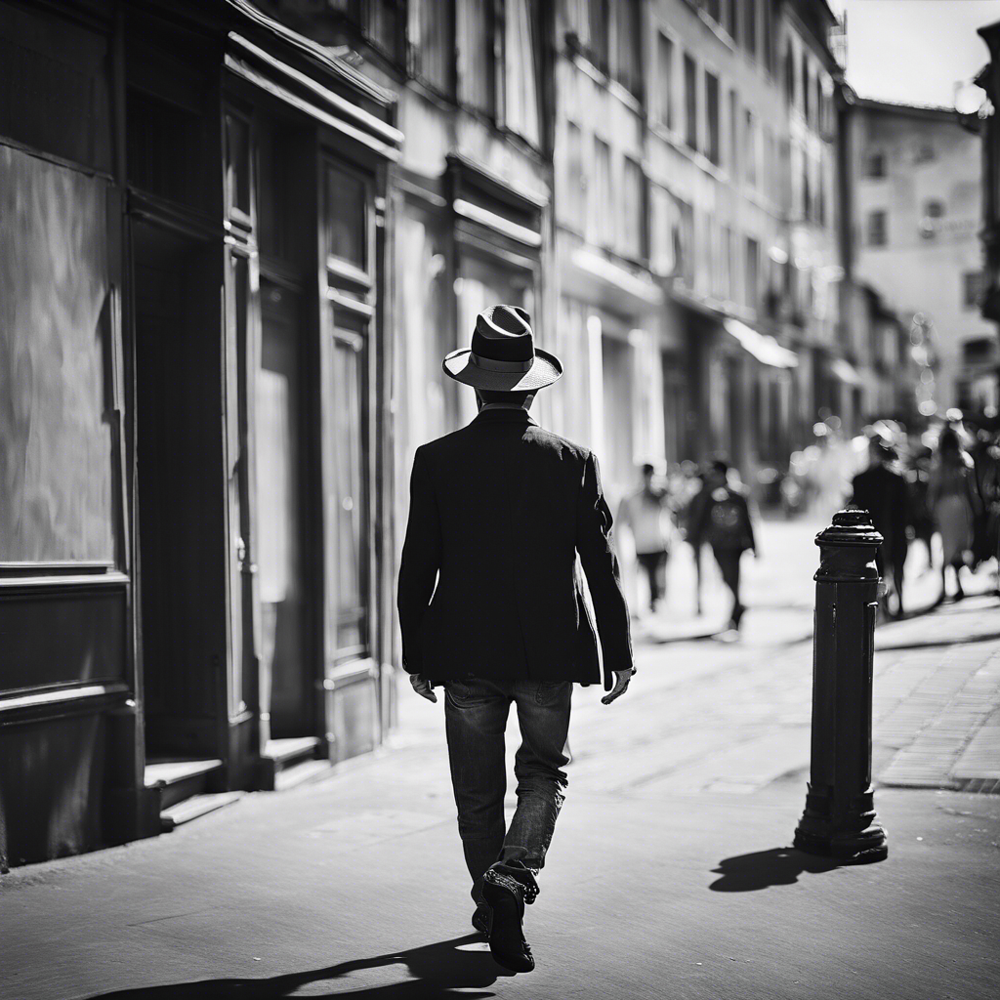

In [ ]:
img = Image.open('/content/man_hat.png')

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 9.78s


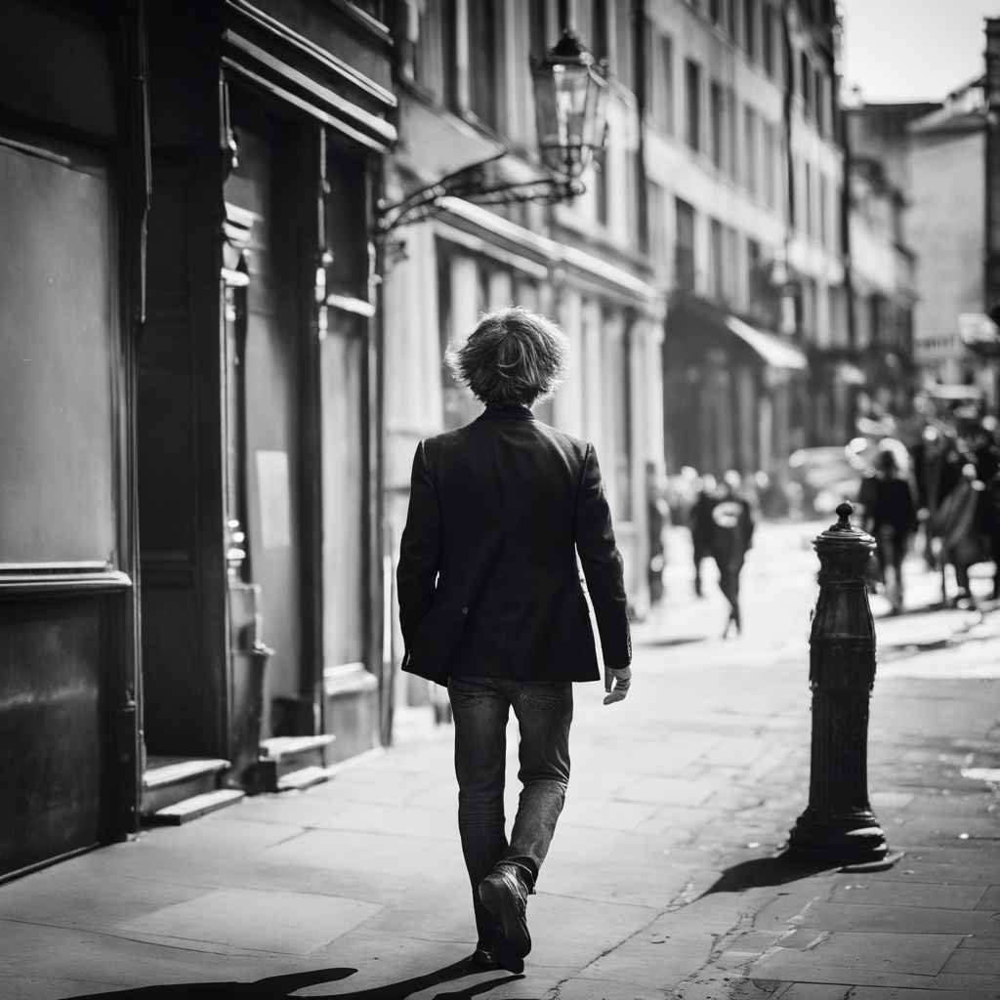

In [ ]:
answers = stability_api.generate(
    prompt="For the man in the middle of the image, show his hair",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.6, # Set the strength of our prompt in relation to our initial image.
    seed=185764, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=80, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

## Task 5: Background change (20 pts)
In this task, your objective is to alter the background of a given image while keeping the foreground elements or similar intact. You will utilize the Stability AI API to accomplish this.

##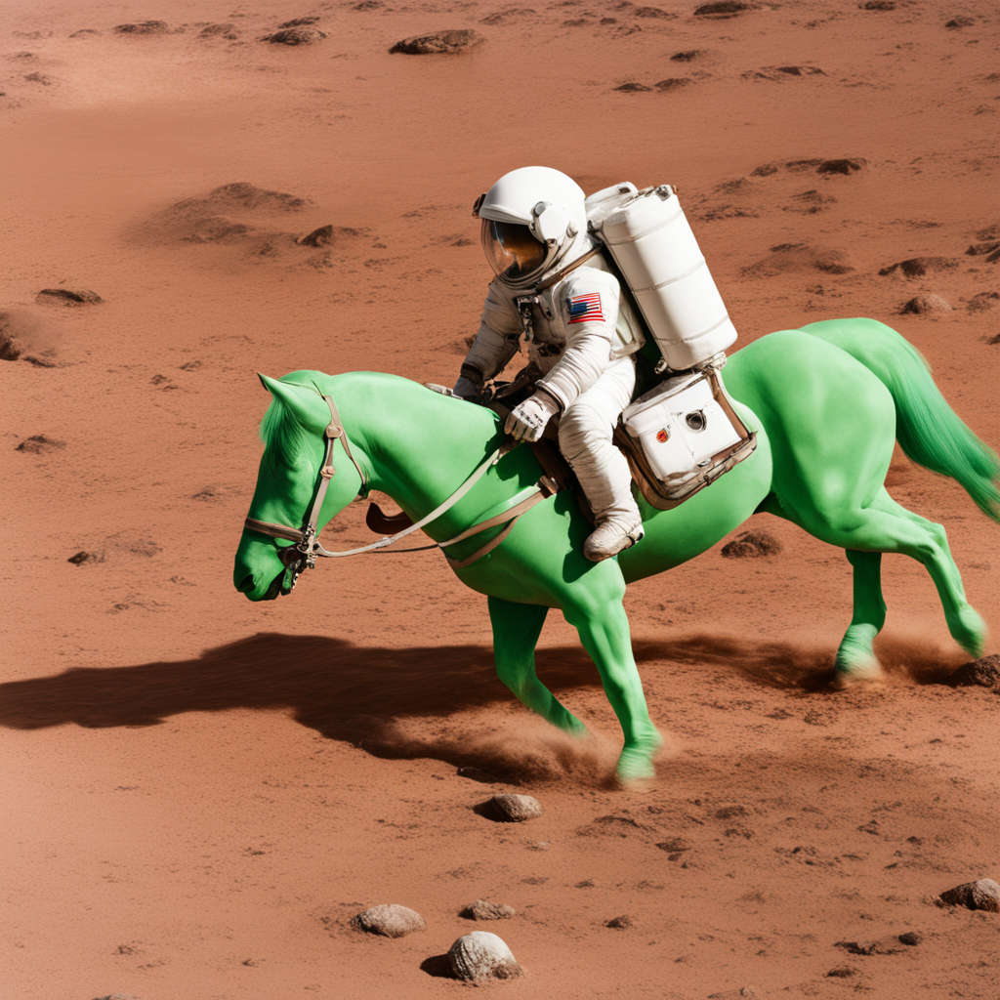

In [ ]:
img = Image.open('/content/spacehorse.png')

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 10.23s


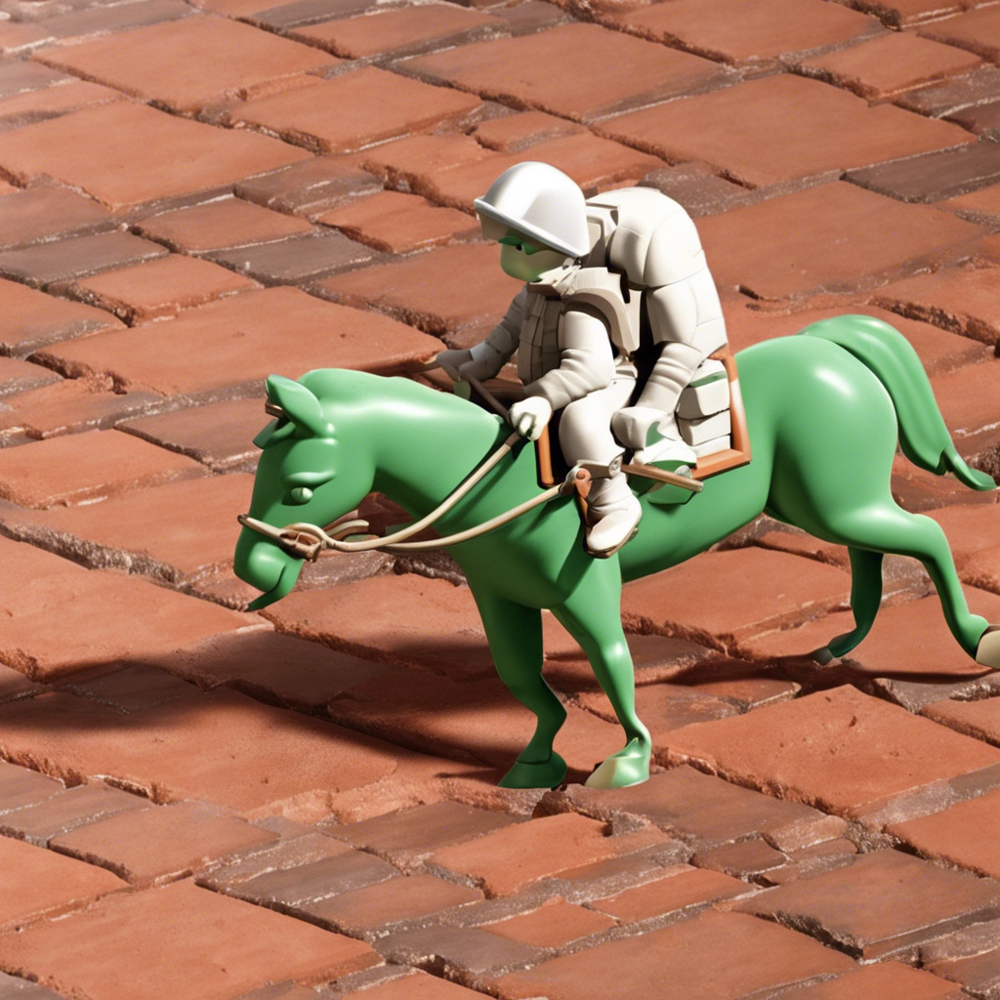

In [ ]:
answers = stability_api.generate(
    prompt="Convert the Background of this image to coblestone brick",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.6, # Set the strength of our prompt in relation to our initial image.
    seed=18764, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=90, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=9.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

## Task 6: Hand drawn image to digital art (20 pts)

Upload a hand-drawn image and transform it into digital art using the Stability API. You could choose a sketch, a cartoon, or any other hand-drawn image. Set up the transformation parameters and display the transformed image.


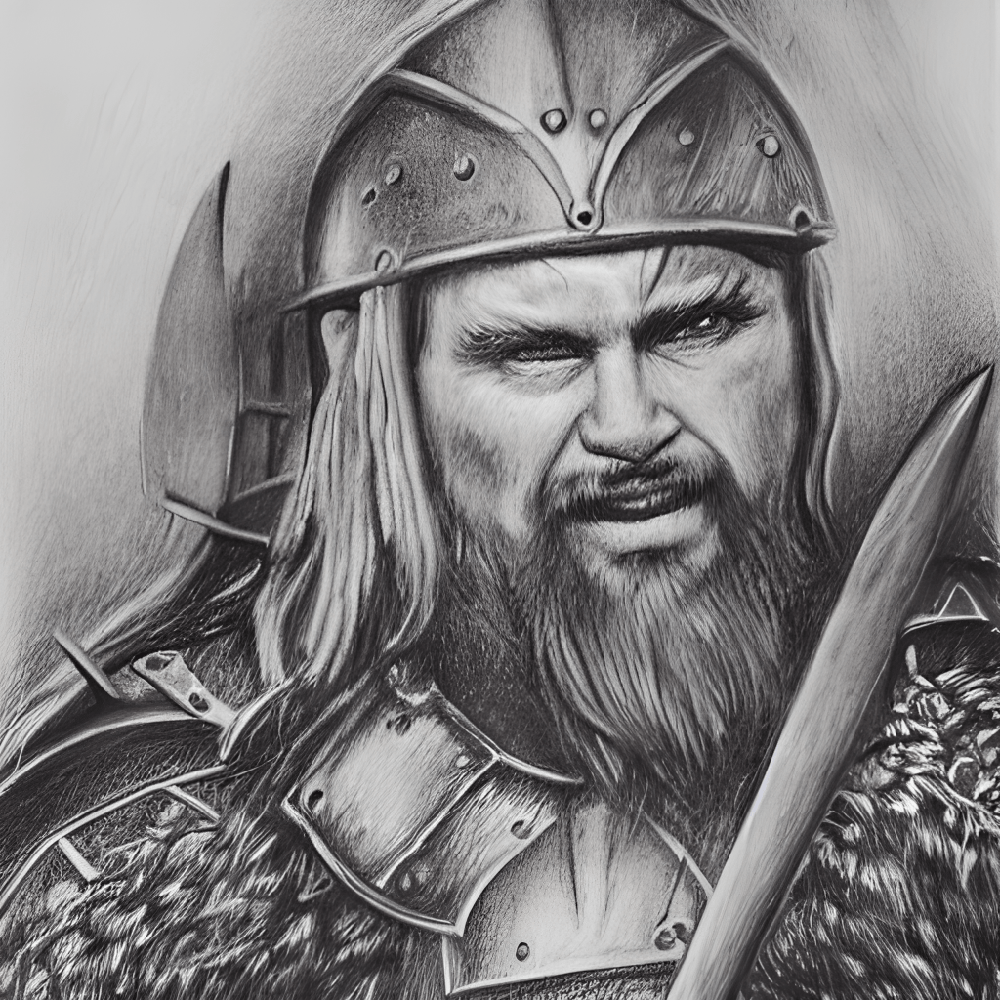

In [ ]:
img = Image.open('/content/viking.png')
display(img)

INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 9.97s


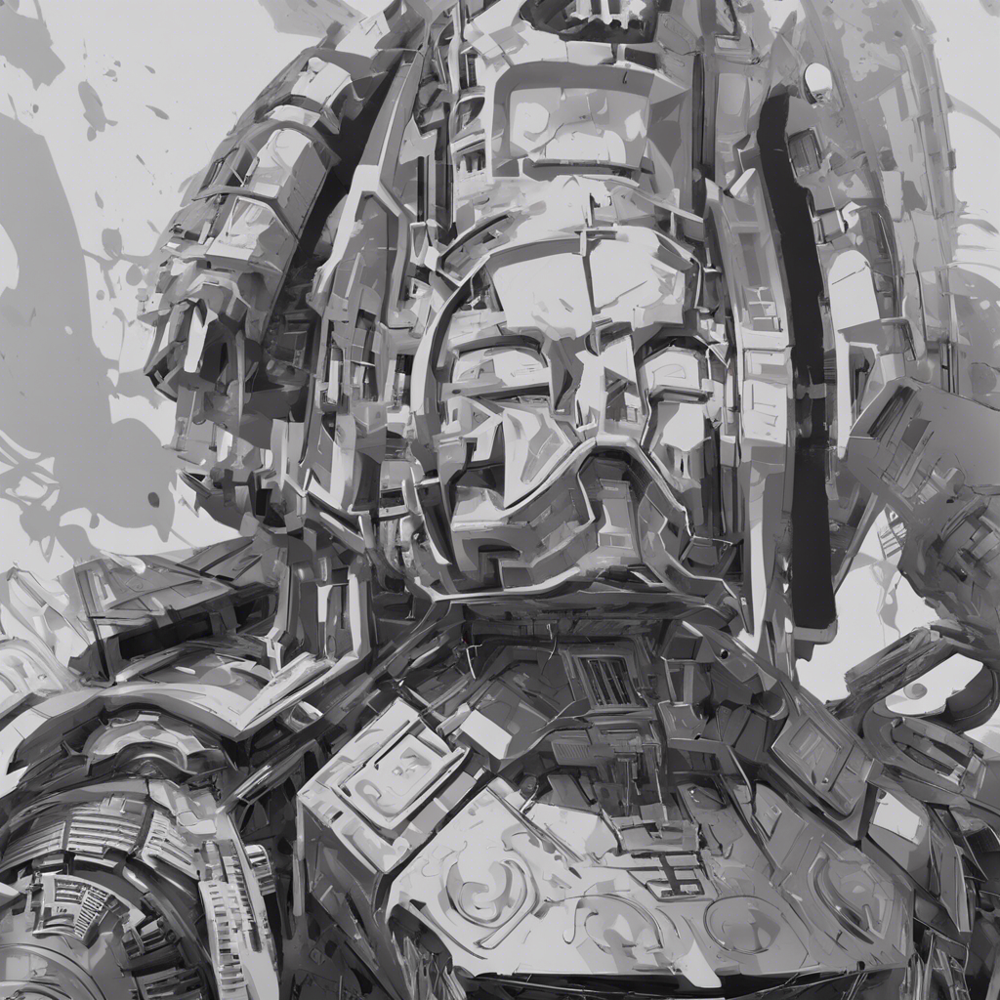

In [ ]:
answers = stability_api.generate(
    prompt="Digital Art Version of this image",
    init_image=img, # Assign our previously generated img as our Initial Image for transformation.
    start_schedule=0.7, # Set the strength of our prompt in relation to our initial image.
    seed=1874, # If attempting to transform an image that was previously generated with our API,
                    # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=90, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=8.0, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, defaults to 512 if not included.
    height=1024, # Generation height, defaults to 512 if not included.
    sampler=generation.SAMPLER_K_DPMPP_2M # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_dpmpp_2m if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped.
# If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary)) # Set our resulting initial image generation as 'img2' to avoid overwriting our previous 'img' generation.
            display(img2)

## Task 7: Remove photobomber (Bonus 20 pts)
Remove the photobomber cat from the image using the Stability API. You will need to set up the prompt and display the transformed image.

Given below is the way to create a mask using segmentation model. You can use this mask to remove the cat from the image.

###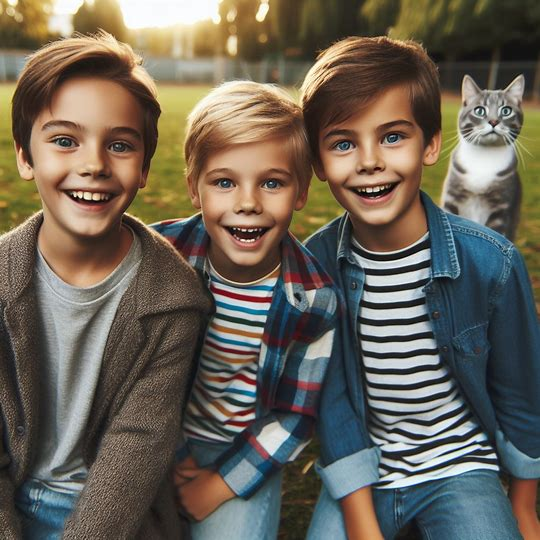

`label_ids_to_fuse` unset. No instance will be fused.


True

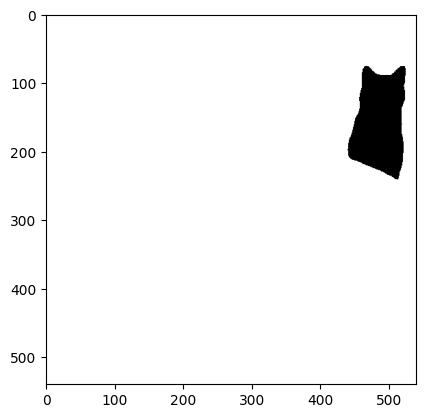

In [ ]:
from transformers import MaskFormerFeatureExtractor, MaskFormerForInstanceSegmentation
from PIL import Image
import requests
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Load MaskFormer model
feature_extractor = MaskFormerFeatureExtractor.from_pretrained("facebook/maskformer-swin-base-coco")
model = MaskFormerForInstanceSegmentation.from_pretrained("facebook/maskformer-swin-base-coco")

# Load image
image = Image.open('photobomb.jpeg')

# Preprocess image for MaskFormer
inputs = feature_extractor(images=image, return_tensors="pt")

# Get segmentation prediction
outputs = model(**inputs)
result = feature_extractor.post_process_panoptic_segmentation(outputs, target_sizes=[image.size[::-1]])[0]
predicted_panoptic_map = result["segmentation"]


image_np = np.array(image)
# Extract cat segmentation mask
cat_mask = np.zeros_like(predicted_panoptic_map)  # Initialize mask
cat_class_id = 4
cat_mask[predicted_panoptic_map == cat_class_id] = 1
# Convert segmentation mask to OpenCV format for processing
cat_mask_opencv = cv2.resize(cat_mask.astype(np.uint8), (image_np.shape[1], image_np.shape[0]), interpolation=cv2.INTER_NEAREST)

# Create photobomber mask (adjust threshold as desired)
threshold = 0.9
thresholded_mask = np.where(cat_mask_opencv > threshold, 0, 1).astype(np.uint8)  # Invert the mask

# Convert the mask to a 3-channel image
thresholded_mask_3ch = cv2.cvtColor(thresholded_mask, cv2.COLOR_GRAY2BGR)

# Display the mask
plt.imshow(thresholded_mask_3ch * 255, cmap='gray')
# saving the mask
cv2.imwrite('mask.png', thresholded_mask_3ch * 255)


### Feathering the edges of our mask generally helps provide a better result. Alternately, you can feather the mask in a suite like Photoshop or GIMP.


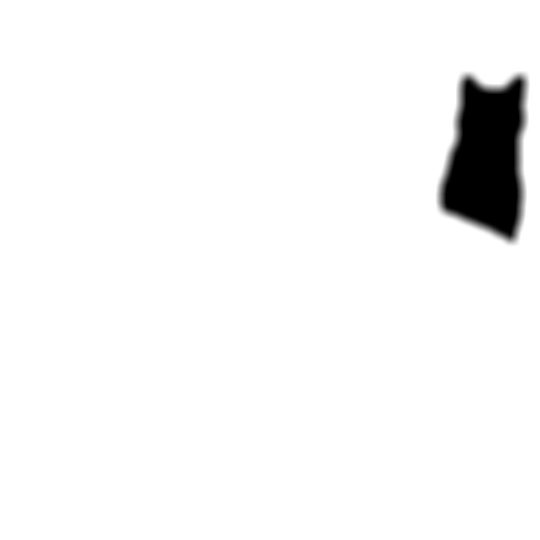

In [ ]:
from torchvision.transforms import GaussianBlur
mask_i = Image.open('mask.png')


blur = GaussianBlur(11,20)
mask = blur(mask_i)
mask

### TODO: Experiment with different prompts and parameters to remove the cat from the background of the image while keeping the rest of the image same


INFO:stability_sdk.client:Sending request.
INFO:stability_sdk.client:Got answer  with artifact types ['ARTIFACT_IMAGE'] in 9.20s


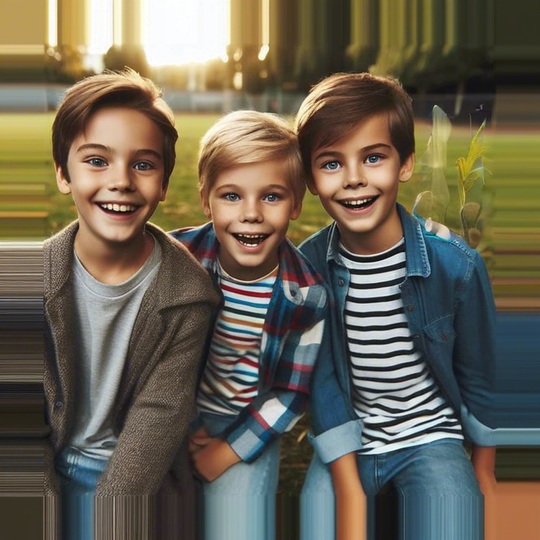

In [ ]:
answers = stability_api.generate(
    prompt="A grassy field",
    init_image=image,
    mask_image=mask,
    start_schedule=0.85,
    seed=44332211, # If attempting to transform an image that was previously generated with our API,
                   # initial images benefit from having their own distinct seed rather than using the seed of the original image generation.
    steps=100, # Amount of inference steps performed on image generation. Defaults to 30.
    cfg_scale=7, # Influences how strongly your generation is guided to match your prompt.
                   # Setting this value higher increases the strength in which it tries to match your prompt.
                   # Defaults to 7.0 if not specified.
    width=1024, # Generation width, if not included defaults to 512 or 1024 depending on the engine.
    height=1024, # Generation height, if not included defaults to 512 or 1024 depending on the engine.
    sampler=generation.SAMPLER_K_EULER_ANCESTRAL # Choose which sampler we want to denoise our generation with.
                                                 # Defaults to k_lms if not specified. Clip Guidance only supports ancestral samplers.
                                                 # (Available Samplers: ddim, plms, k_euler, k_euler_ancestral, k_heun, k_dpm_2, k_dpm_2_ancestral, k_dpmpp_2s_ancestral, k_lms, k_dpmpp_2m, k_dpmpp_sde)
)

# Set up our warning to print to the console if the adult content classifier is tripped. If adult content classifier is not tripped, display generated image.
for resp in answers:
    for artifact in resp.artifacts:
        if artifact.finish_reason == generation.FILTER:
            warnings.warn(
                "Your request activated the API's safety filters and could not be processed."
                "Please modify the prompt and try again.")
        if artifact.type == generation.ARTIFACT_IMAGE:
            img2 = Image.open(io.BytesIO(artifact.binary))
            display(img2)